## Sim Demo

### Imports

In [73]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [74]:
from env.imports import *

In [75]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run) 

absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn


<module 'sim.sim_run' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/sim/sim_run.py'>

#### Check job specs

In [76]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 0.0%
RAM Usage: 4.0%
Available RAM: 967.2G
Total RAM: 1007.0G
52.4G


In [77]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


None
Available GPUs: 1
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.00 GB


In [78]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |


In [79]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

#### Simulation tests <a id="sims"></a>

In [80]:
from data.data_load import load_connectome, load_transcriptome, load_coords, load_network_labels

In [18]:
load_transcriptome(parcellation='iPA_183', gene_list='0.2', dataset='AHBA', run_PCA=False, omit_subcortical=False, hemisphere='both', impute_strategy='mirror_interpolate', sort_genes='refgenome', return_valid_genes=False, null_model='none', random_seed=42)


                0         1         2         3         4         5      \
gene_symbol      A1BG  A1BG-AS1       A2M     A2ML1   A3GALT2    A4GALT   
1            0.657938  0.717807  0.400835  0.381983  0.450817  0.343365   
2                 NaN       NaN       NaN       NaN       NaN       NaN   
3            0.375432  0.557492  0.585811  0.496911  0.479465  0.480557   
4            0.523071  0.652621  0.366135  0.509562  0.489032  0.507291   

                6         7         8         9      ...     15623     15624  \
gene_symbol      AAAS      AACS   AADACL3     AADAT  ...      ZW10    ZWILCH   
1            0.439016  0.839129   0.36599  0.691575  ...  0.565288  0.590317   
2                 NaN       NaN       NaN       NaN  ...       NaN       NaN   
3            0.647116  0.707617  0.412687  0.702439  ...  0.670617  0.473682   
4            0.417454  0.719705  0.415752  0.530463  ...   0.58893  0.579833   

                15625     15626     15627     15628     15629     15

array([], shape=(183, 0), dtype=float64)

In [81]:
absolute_data_path = '/scratch/asr655/neuroinformatics/GeneEx2Conn_data'
BHA2_path = absolute_data_path + '/BHA2/iPA_568'
BHA2_fc_path = BHA2_path + '/fc'

In [82]:
# # Get list of all CSV files in directory
# csv_files = [f for f in os.listdir(BHA2_fc_path) if f.endswith('.csv')]

# # Initialize list to store arrays
# arrays = []

# # Load all CSV files
# for csv_file in csv_files:
#     # Read with space separator since files are space-delimited
#     df = pd.read_csv(os.path.join(BHA2_fc_path, csv_file), sep=' ', header=None)
#     # Convert any string representations to numeric values
#     df = df.apply(pd.to_numeric, errors='coerce')
#     # Convert dataframe to numpy array and append
#     arrays.append(df.to_numpy())
    
# # Calculate mean connectivity matrix
# mean_connectivity = np.mean(arrays, axis=0)

# # Save mean connectivity matrix to csv
# mean_df = pd.DataFrame(mean_connectivity)
# mean_df.to_csv(os.path.join(BHA2_fc_path, 'fc_mean.csv'), index=False, header=False)

# # Create figure to visualize mean connectivity
# plt.figure(figsize=(10,8))
# plt.imshow(mean_connectivity, cmap='RdBu_r', vmin=-1, vmax=1)
# plt.colorbar()
# plt.title('Mean Connectivity Matrix')
# plt.show()

# # Display mean connectivity matrix
# print("Mean connectivity:")
# display(pd.DataFrame(mean_connectivity))

In [83]:
X = load_transcriptome(parcellation='iPA_183', gene_list='0.2', dataset='AHBA', run_PCA=False, omit_subcortical=False, hemisphere='both', impute_strategy='mirror_interpolate', sort_genes='refgenome', return_valid_genes=False, null_model='none', random_seed=42)


gene_symbol      A1BG  A1BG-AS1       A2M     A2ML1   A3GALT2    A4GALT  \
1            0.657938  0.717807  0.400835  0.381983  0.450817  0.343365   
2                 NaN       NaN       NaN       NaN       NaN       NaN   
3            0.375432  0.557492  0.585811  0.496911  0.479465  0.480557   
4            0.523071  0.652621  0.366135  0.509562  0.489032  0.507291   
5            0.547781  0.605232  0.540952  0.405898  0.545013  0.653176   

gene_symbol      AAAS      AACS   AADACL3     AADAT  ...      ZW10    ZWILCH  \
1            0.439016  0.839129  0.365990  0.691575  ...  0.565288  0.590317   
2                 NaN       NaN       NaN       NaN  ...       NaN       NaN   
3            0.647116  0.707617  0.412687  0.702439  ...  0.670617  0.473682   
4            0.417454  0.719705  0.415752  0.530463  ...  0.588930  0.579833   
5            0.501991  0.717018  0.520258  0.417392  ...  0.570881  0.666391   

gene_symbol     ZWINT      ZXDA      ZXDB      ZXDC    ZYG11B       

In [84]:
Y = load_connectome(parcellation='iPA_183')
print(Y)
print(Y.shape)

[[0.         0.17561702 0.28216942 ... 0.29594169 0.2457213  0.27097152]
 [0.17561702 0.         0.21294289 ... 0.37171529 0.47270243 0.39883024]
 [0.28216942 0.21294289 0.         ... 0.15405294 0.13554151 0.15667567]
 ...
 [0.29594169 0.37171529 0.15405294 ... 0.         0.69735088 0.69576054]
 [0.2457213  0.47270243 0.13554151 ... 0.69735088 0.         0.85380691]
 [0.27097152 0.39883024 0.15667567 ... 0.69576054 0.85380691 0.        ]]
(183, 183)


In [91]:
coordinates = load_coords(parcellation='iPA_183')
print(coordinates)
print(coordinates.shape)

[[-8.2443e-01  2.7183e+01 -1.4845e+01]
 [ 4.3231e+01  1.2201e+01  4.7894e+01]
 [-4.6289e+01 -1.2818e+01  4.7670e+01]
 [ 2.6474e+01  2.3416e+01  5.0775e+01]
 [ 4.4694e+01  3.9350e+01 -1.1486e+01]
 [ 4.3511e+00 -1.1805e+01  4.7756e+01]
 [-2.3228e+01  3.1105e+01  4.6846e+01]
 [ 5.5027e+01  3.7614e+00  1.3917e+01]
 [-5.3101e+01  2.0556e+01  1.7703e+01]
 [ 1.4168e+01  1.5955e+01 -1.9275e+01]
 [-4.4099e+01  3.0859e+00  4.9440e+01]
 [ 7.7708e+00  4.3656e+01  1.6236e+01]
 [ 3.8124e+01  3.1451e+01  3.6359e+01]
 [ 2.8744e+01  5.3045e+01 -1.1991e+01]
 [-3.1405e+01  2.5696e+01 -1.7072e+01]
 [ 1.3768e+01  1.0991e+01  6.4894e+01]
 [-7.6210e+00  4.1087e+01 -2.2274e+01]
 [-2.6672e+01  6.1534e+01  3.2095e-01]
 [ 1.1675e+01 -7.8596e+00  6.8700e+01]
 [-2.7547e+01  5.5286e+01  1.9475e+01]
 [-9.1843e+00  5.0076e+00  6.4103e+01]
 [ 8.2527e+00  6.4137e+01  8.3744e+00]
 [ 5.3116e+01  1.7543e+01  8.5161e+00]
 [ 9.6398e+00  4.0199e+01 -2.2120e+01]
 [-4.4623e+01  2.4316e+01  1.6633e+00]
 [ 4.3160e+01 -8.1265e+00

In [92]:
labels, network_labels = load_network_labels(parcellation='iPA_183')
print(labels)


[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183]


absolute_root_path /scratch/asr655/neuroinformatics/GeneEx2Conn
gene_symbol      A1BG  A1BG-AS1       A2M     A2ML1   A3GALT2    A4GALT  \
1            0.645452  0.765346  0.628784  0.202098  0.571577  0.660580   
2            0.472860  0.780874  0.458606  0.213585  0.579020  0.593582   
3            0.529791  0.600449  0.541138  0.539002  0.415152  0.447878   
4            0.409091  0.772410  0.622108  0.296513  0.438097  0.476987   
5            0.480008  0.383730  0.656022  0.813533  0.622371  0.442278   

gene_symbol      AAAS      AACS   AADACL3     AADAT  ...      ZW10    ZWILCH  \
1            0.515693  0.809585  0.480017  0.415340  ...  0.471785  0.661434   
2            0.509211  0.821951  0.349810  0.528567  ...  0.465156  0.628013   
3            0.356211  0.646879  0.397198  0.537837  ...  0.458086  0.470921   
4            0.761344  0.890743  0.343076  0.694940  ...  0.806565  0.676090   
5            0.421950  0.752321  0.661961  0.464201  ...  0.519217  0.793321   

gene

wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: do6svkis
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/do6svkis
Initialized sweep with ID: do6svkis


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0494
Best val loss so far at epoch 3: 0.0293
Best val loss so far at epoch 4: 0.0266
Best val loss so far at epoch 5: 0.0229
Epoch 5/100, Train Loss: 0.0696, Val Loss: 0.0229, Time: 2.05s
Best val loss so far at epoch 6: 0.0200
Best val loss so far at epoch 8: 0.0197
Best val loss so far at epoch 9: 0.0185
Best val loss so far at epoch 10: 0.0182
Epoch 10/100, Train Loss: 0.0345, Val Loss: 0.0182, Time: 2.09s
Best val loss so far at epoch 12: 0.0172
Epoch 15/100, Train Loss: 0.0182, Val Loss: 0.0182, Time: 2.01s
Best val loss so far at epoch 16: 0.0165
Epoch 20/100, Train Loss: 0.0104, Val Loss: 0.0186, Time: 1.98s
Best val loss so far at epoch 2

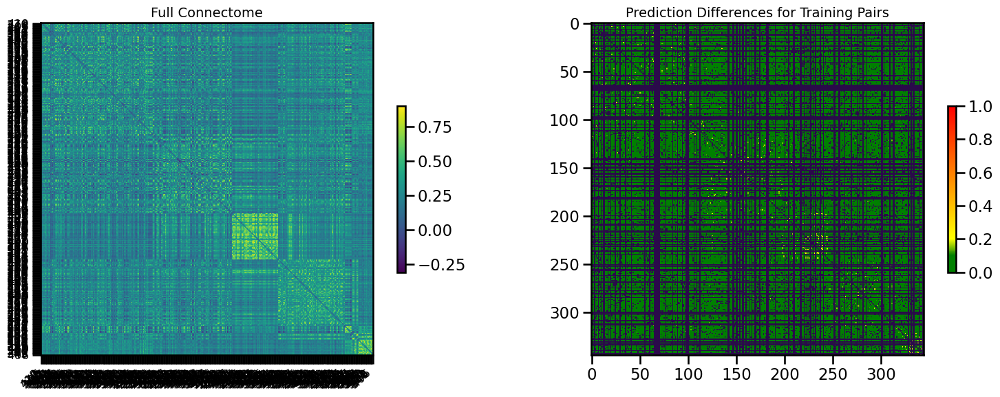

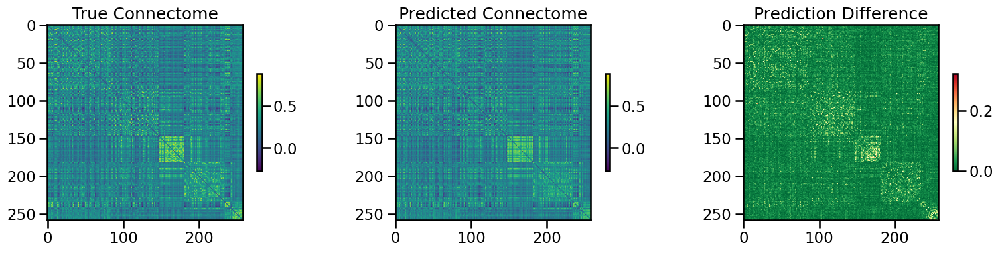

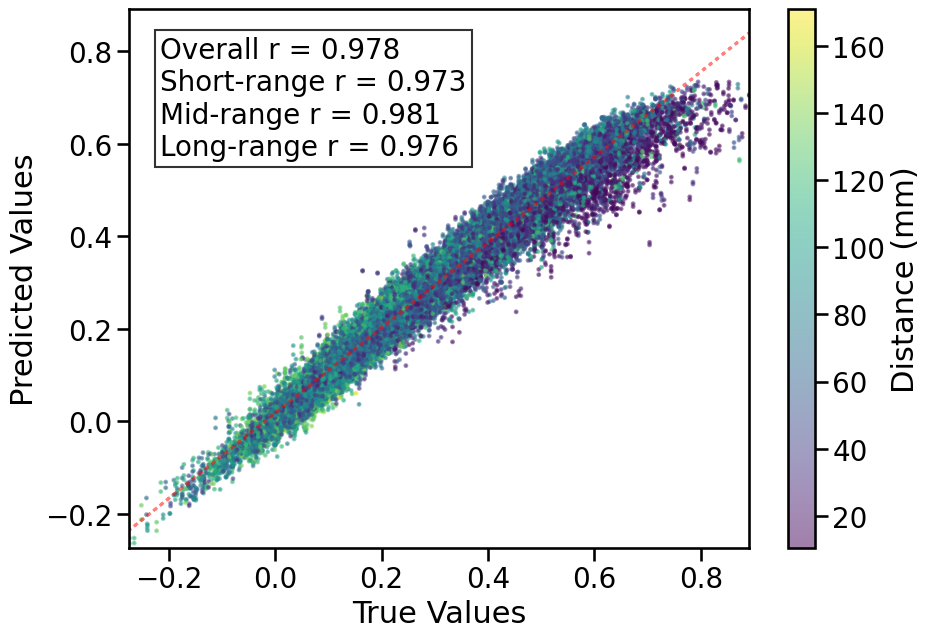

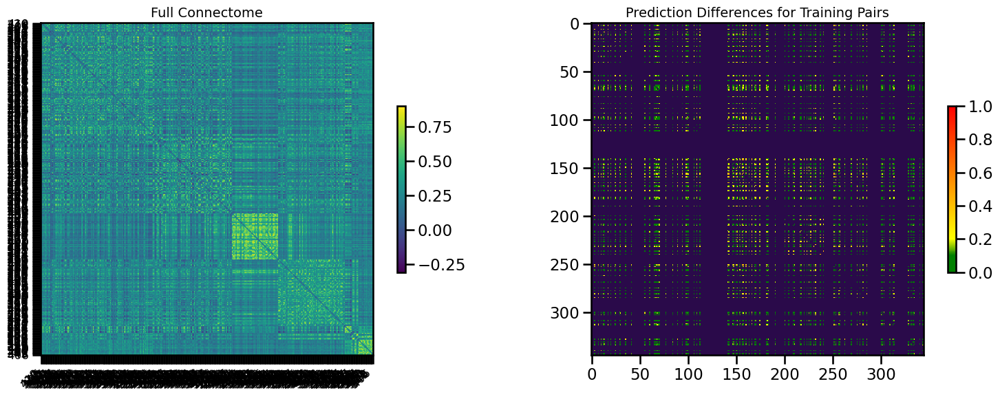

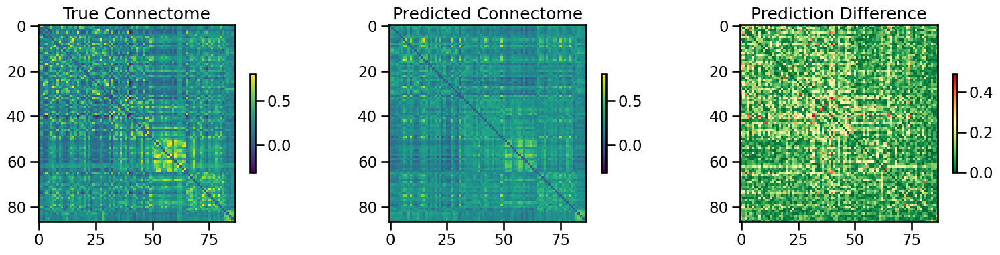

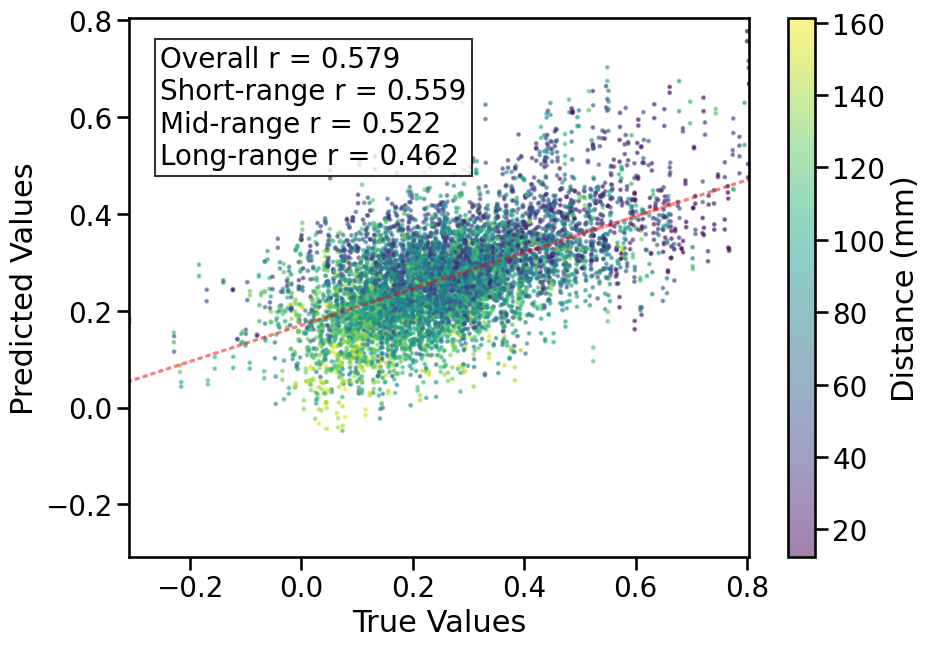


TRAIN METRICS: {'mse': 0.0010291002, 'mae': 0.022208214, 'r2': 0.9550408910736942, 'pearson_r': 0.9780956191791307, 'short_r': 0.9725450626862406, 'mid_r': 0.9806922809406092, 'long_r': 0.976346303792086, 'geodesic_distance': 10.307056483077627}
TEST METRICS: {'mse': 0.016071655, 'mae': 0.09844521, 'r2': 0.3295242434294132, 'pearson_r': 0.5790727173872932, 'short_r': 0.5590693012290379, 'mid_r': 0.5219999311774683, 'long_r': 0.46214546105241383, 'geodesic_distance': 8.260857250666296}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.4894
Best val loss so far at epoch 2: 0.0822
Best val loss so far at epoch 3: 0.0384
Best val loss so far at epoch 4: 0.0352
Best val loss so far at epoch 5: 0.0314
Epoch 5/100, Train Loss: 0.0693, Val Loss: 0.0314, Time: 2.08s
Best val loss so far at epoch 6: 0.0272
Best val loss so far at epoch 7: 0.0235
Best val loss so far at epoch 10: 0.0217
Epoch 10/100, Train Loss: 0.0342, Val Loss: 0.0217, Time: 2.14s
Best val loss so far at epoch 11: 0.0206
Best val loss so far at epoch 13: 0.0191
Best val loss so far at epoch 15: 0.0187
Epoch 15/100, Train Loss: 0.0190, Val Loss: 0.0187, Time: 1.99s
Best val loss so far at epoch 20: 0.0183
Epoch 20/100,

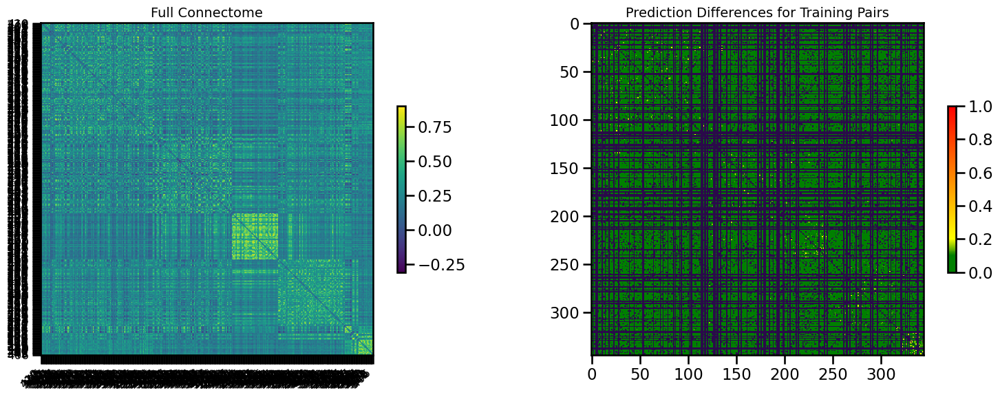

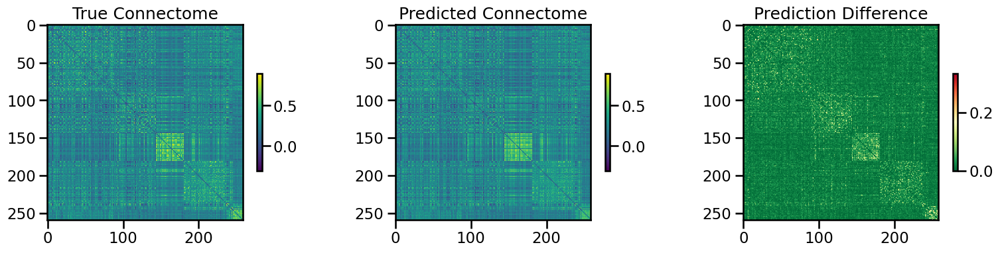

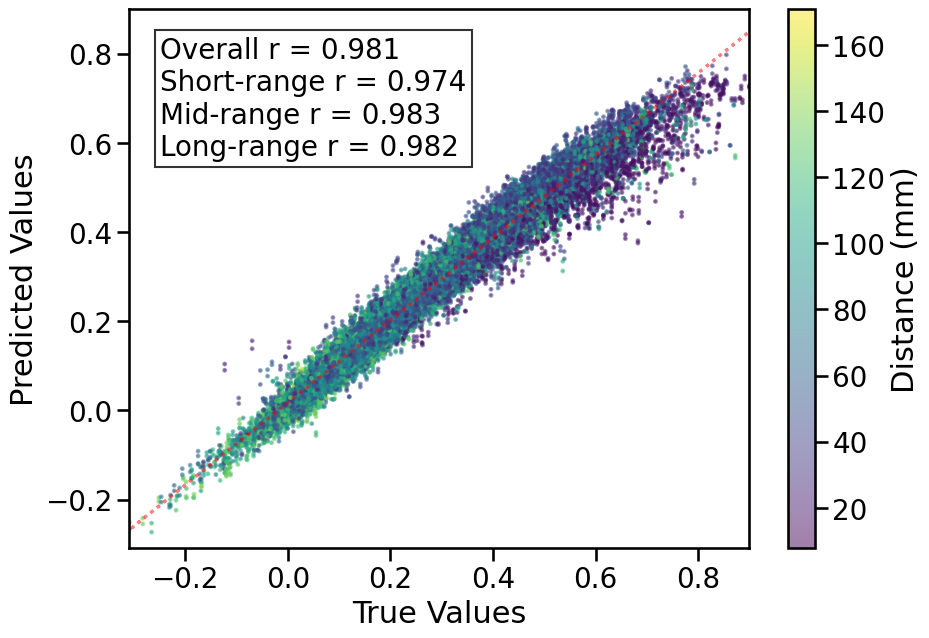

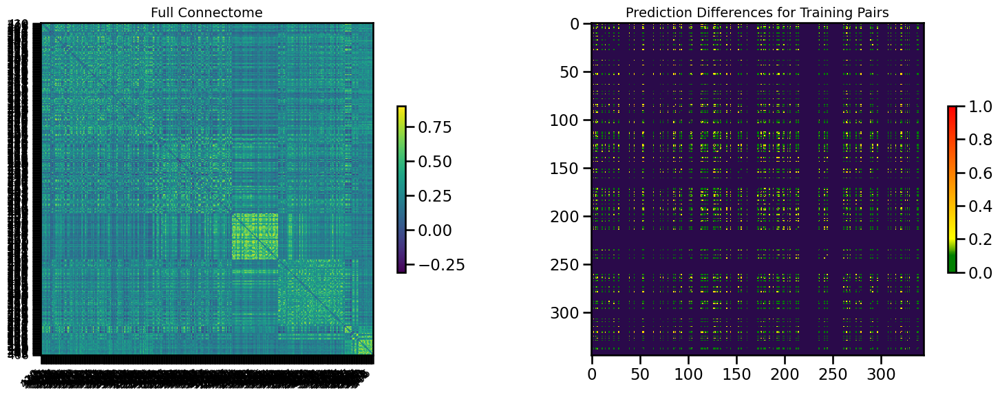

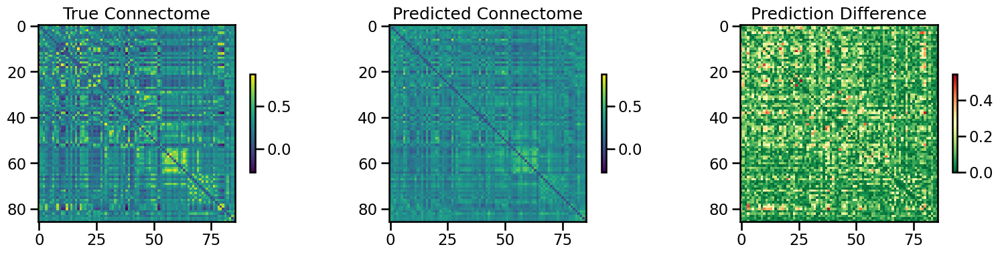

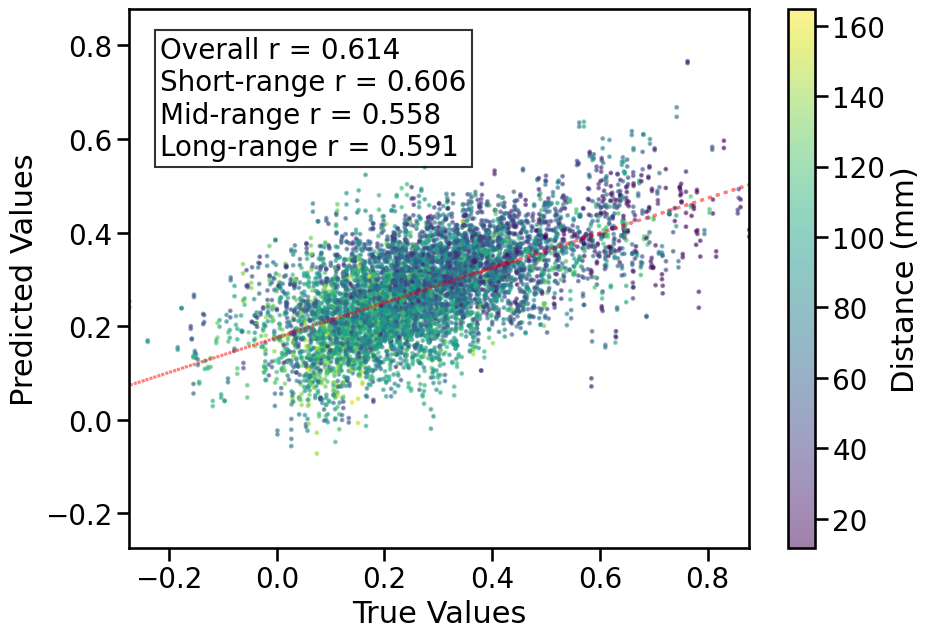


TRAIN METRICS: {'mse': 0.00087848544, 'mae': 0.02043411, 'r2': 0.9599636114134584, 'pearson_r': 0.980696132603044, 'short_r': 0.9741585663370433, 'mid_r': 0.9830837976802091, 'long_r': 0.9817334885250553, 'geodesic_distance': 9.915728927191738}
TEST METRICS: {'mse': 0.016817199, 'mae': 0.09921435, 'r2': 0.37606828022562155, 'pearson_r': 0.6137749071455921, 'short_r': 0.6061059679721049, 'mid_r': 0.5577621313280308, 'long_r': 0.5908878264550104, 'geodesic_distance': 10.849778972675244}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.0447
Best val loss so far at epoch 3: 0.0368
Best val loss so far at epoch 4: 0.0266
Best val loss so far at epoch 5: 0.0194
Epoch 5/100, Train Loss: 0.0738, Val Loss: 0.0194, Time: 2.03s
Best val loss so far at epoch 6: 0.0184
Best val loss so far at epoch 7: 0.0183
Best val loss so far at epoch 9: 0.0167
Epoch 10/100, Train Loss: 0.0377, Val Loss: 0.0180, Time: 2.08s
Best val loss so far at epoch 12: 0.0167
Best val loss so far at epoch 13: 0.0153
Epoch 15/100, Train Loss: 0.0205, Val Loss: 0.0154, Time: 2.05s
Best val loss so far at epoch 17: 0.0150
Best val loss so far at epoch 20: 0.0140
Epoch 20/100, Train Loss: 0.0118, Val Loss: 0.0140, Ti

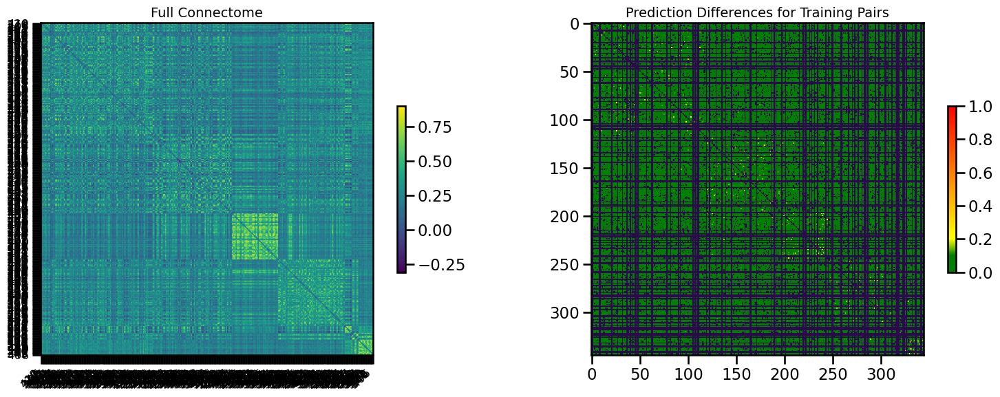

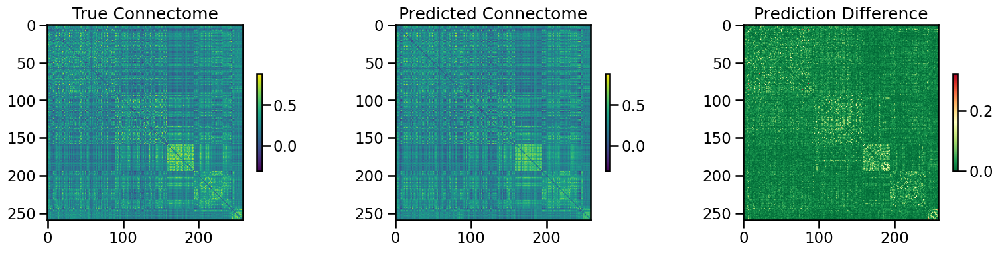

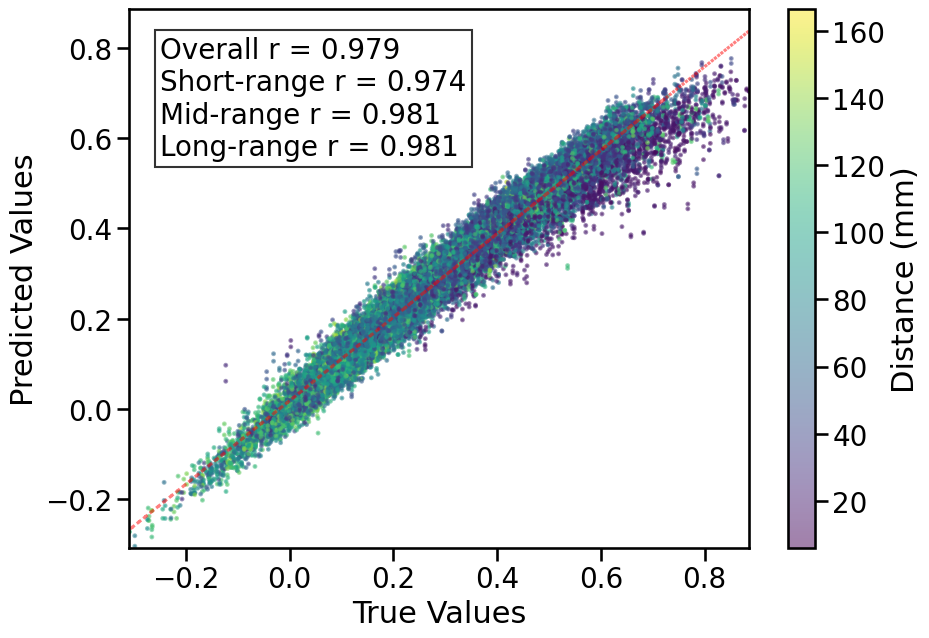

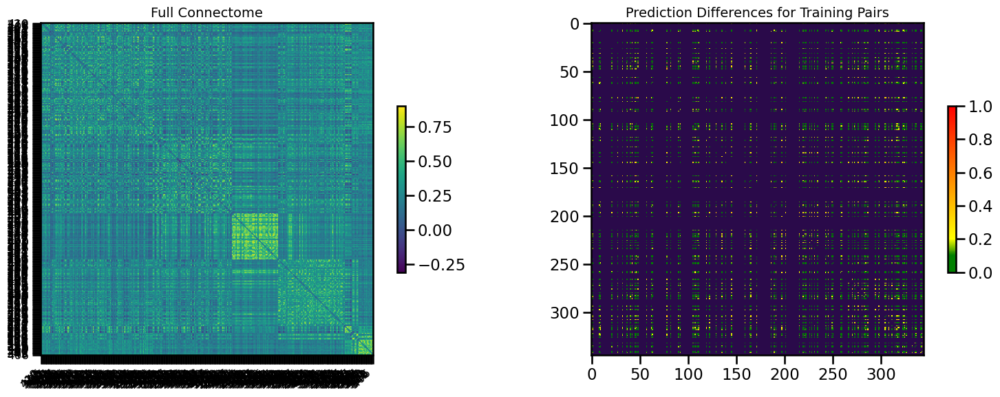

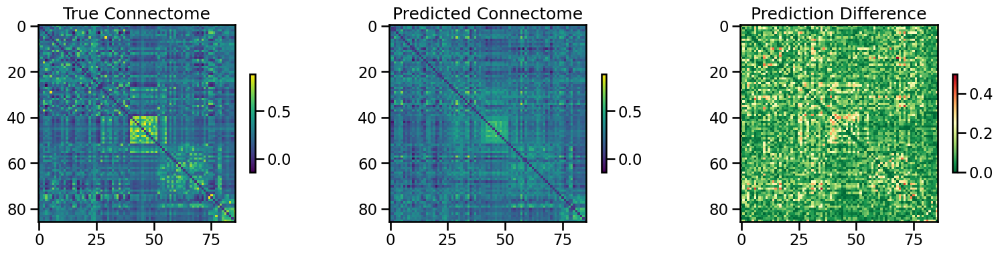

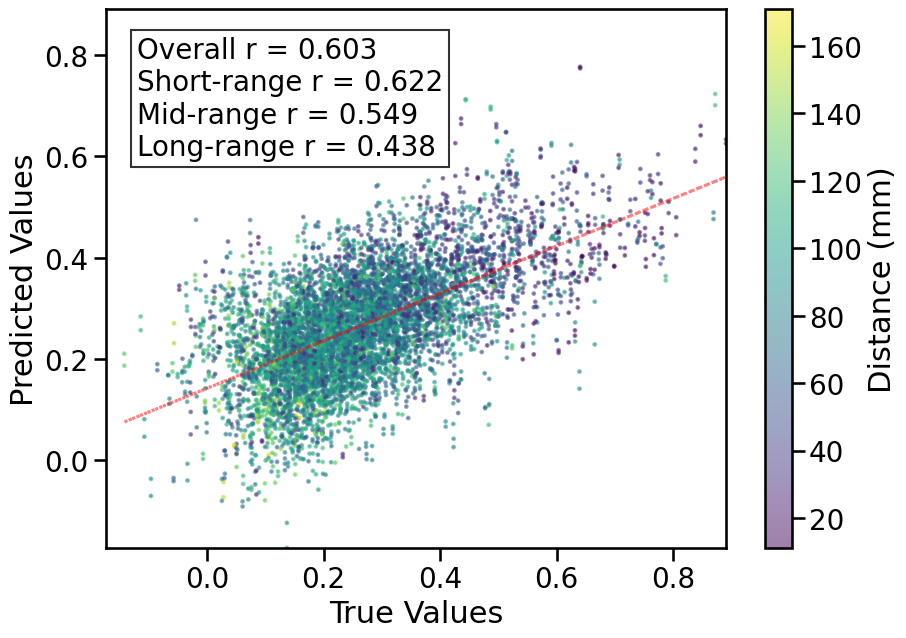


TRAIN METRICS: {'mse': 0.0010145776, 'mae': 0.022330618, 'r2': 0.9577626858824653, 'pearson_r': 0.9793385944115047, 'short_r': 0.973903413431629, 'mid_r': 0.9814301028124441, 'long_r': 0.9806630829588081, 'geodesic_distance': 11.487989068151583}
TEST METRICS: {'mse': 0.0136392005, 'mae': 0.09055448, 'r2': 0.33324669859162526, 'pearson_r': 0.6030346845906656, 'short_r': 0.6219286884163528, 'mid_r': 0.5494590841044075, 'long_r': 0.4383806801272252, 'geodesic_distance': 7.799051333200991}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'hidden_dims': [256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.2, 'weight_decay': 0.0001, 'epochs': 100}
Number of learnable parameters in MLP: 3812609
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.09 GB
Best val loss so far at epoch 1: 0.1011
Best val loss so far at epoch 2: 0.0432
Best val loss so far at epoch 3: 0.0374
Best val loss so far at epoch 4: 0.0317
Best val loss so far at epoch 5: 0.0228
Epoch 5/100, Train Loss: 0.0707, Val Loss: 0.0228, Time: 2.02s
Best val loss so far at epoch 6: 0.0210
Best val loss so far at epoch 7: 0.0202
Best val loss so far at epoch 8: 0.0191
Best val loss so far at epoch 10: 0.0183
Epoch 10/100, Train Loss: 0.0349, Val Loss: 0.0183, Time: 2.09s
Best val loss so far at epoch 11: 0.0175
Best val loss so far at epoch 12: 0.0173
Best val loss so far at epoch 13: 0.0166
Epoch 15/100, Train Loss: 0.0193, Val Loss: 0.0168, Time: 2.54s
Best val loss 

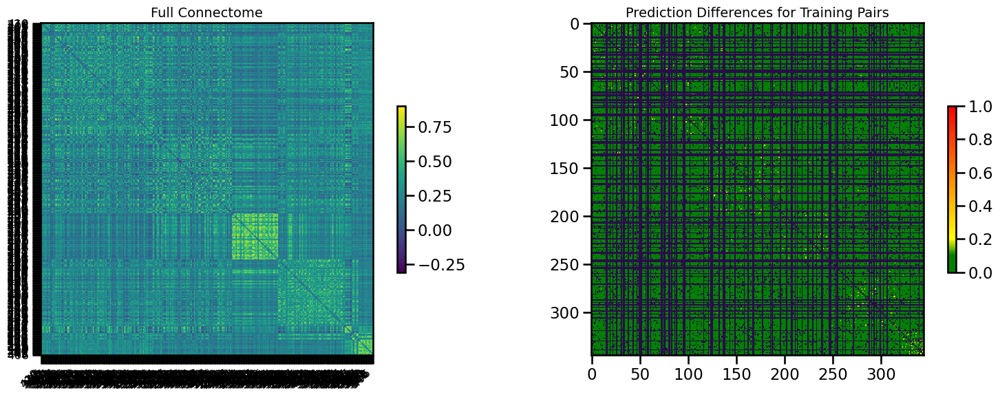

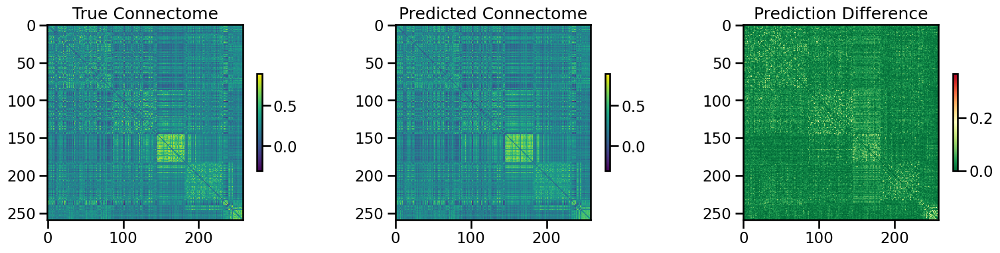

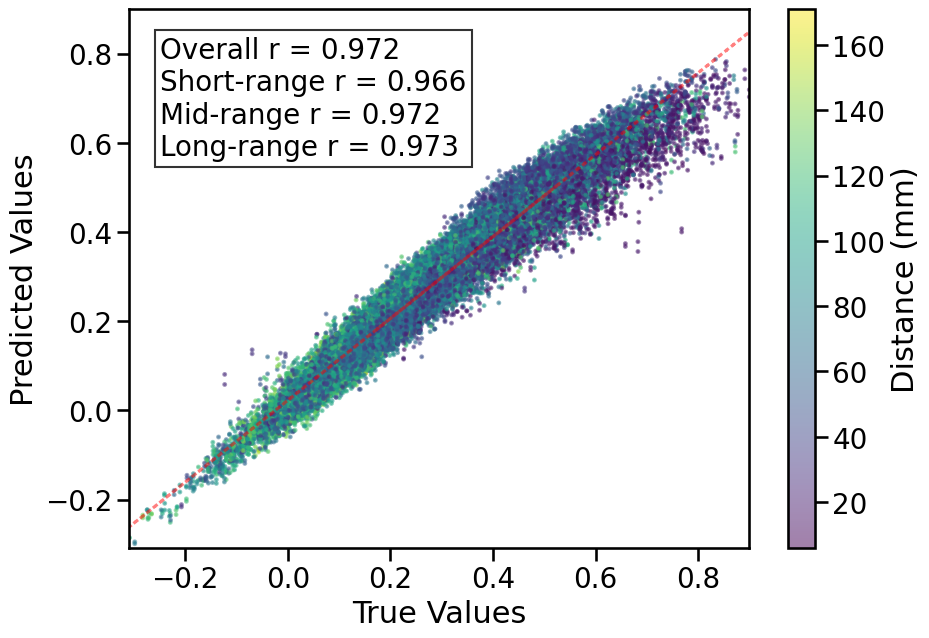

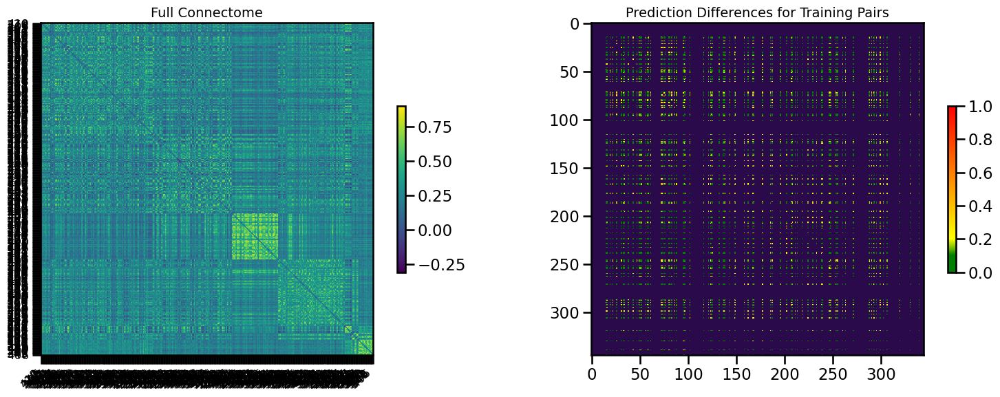

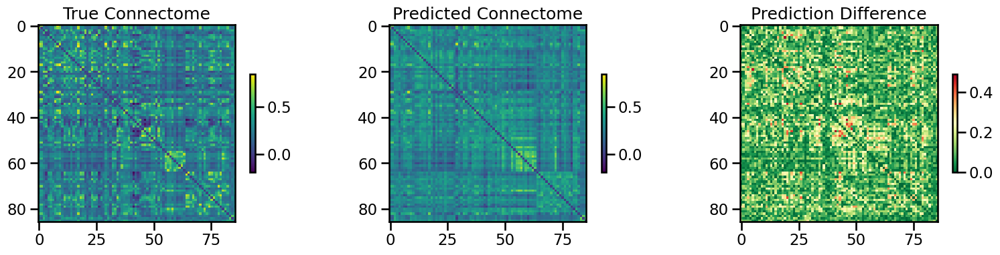

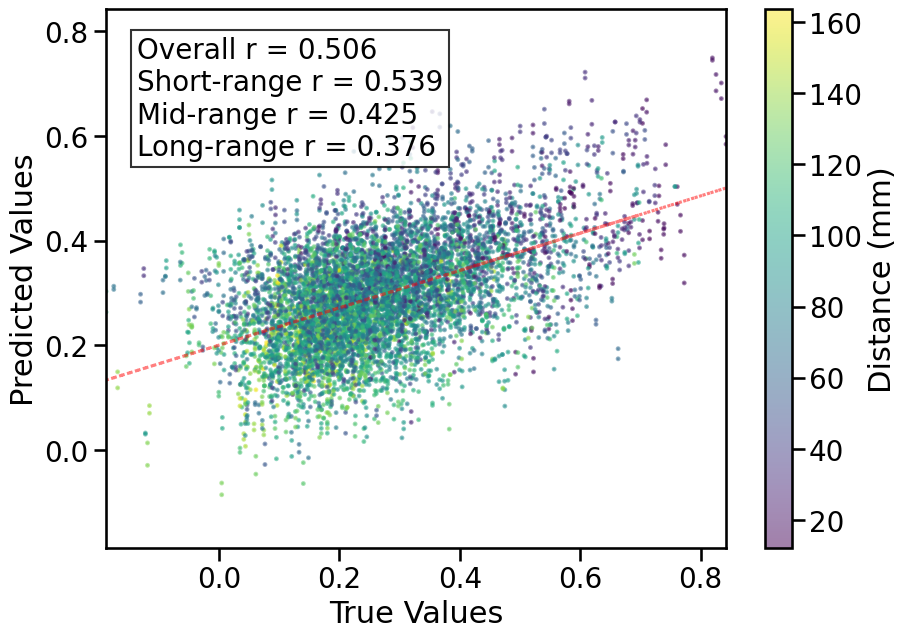


TRAIN METRICS: {'mse': 0.0013432804, 'mae': 0.026910061, 'r2': 0.943916687321629, 'pearson_r': 0.9719457455639366, 'short_r': 0.9661692077013777, 'mid_r': 0.9724226433403867, 'long_r': 0.97324941121725, 'geodesic_distance': 11.087887850467936}
TEST METRICS: {'mse': 0.017439494, 'mae': 0.10354592, 'r2': 0.17876535247275538, 'pearson_r': 0.5055661404506951, 'short_r': 0.5393785124874089, 'mid_r': 0.4245581076402898, 'long_r': 0.37567581065016714, 'geodesic_distance': 8.10866851443446}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'input_dim': 14760, 'binarize': False, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'epochs': 100}
CPU Usage: 0.0%
RAM Usage: 5.2%
Available RAM: 954.7G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  2% |
Sim complete
Simulation completed in 841.14 seconds (14.02 minutes)


5571

In [95]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='iPA_391',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=2,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='none'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
Y shape (455, 455)
feature_name:  transcriptome
processing_type:  None
features ['transcriptome']
X generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: reqk55qc
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/reqk55qc
Initialized sweep with ID: reqk55qc


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 125}
Number of learnable parameters in bilinear low rank model: 73800
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0304
Best val loss so far at epoch 2: 0.0280
Best val loss so far at epoch 3: 0.0262
Best val loss so far at epoch 4: 0.0248
Epoch 5/125, Train Loss: 0.0229, Val Loss: 0.0255, Time: 4.14s
Best val loss so far at epoch 6: 0.0232
Best val loss so far at epoch 7: 0.0230
Best val loss so far at epoch 8: 0.0230
Epoch 10/125, Train Loss: 0.0177, Val Loss: 0.0238, Time: 3.77s
Best val loss so far at epoch 11: 0.0219
Best val loss so far at epoch 12: 0.0216
Best val loss so far at epoch 13: 0.0208
Best val loss so far at epoch 14: 0.0208
Epoch 15/125, Train Loss: 0.0141, Val Loss: 0.0209, Time: 3.9

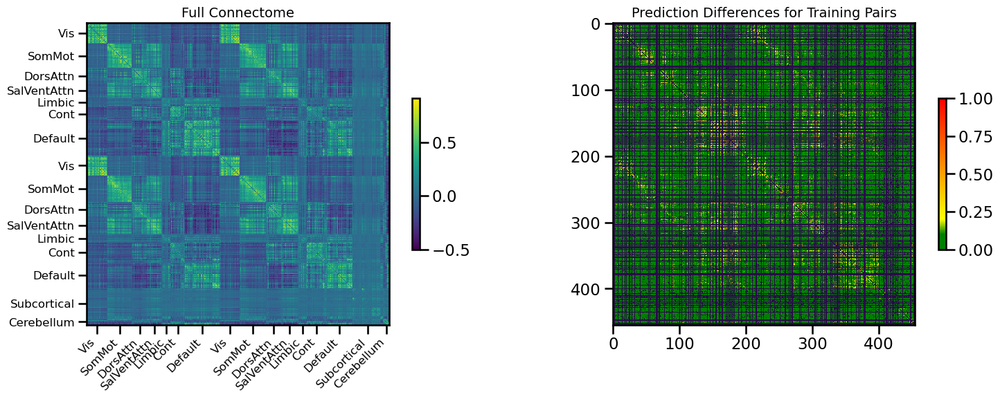

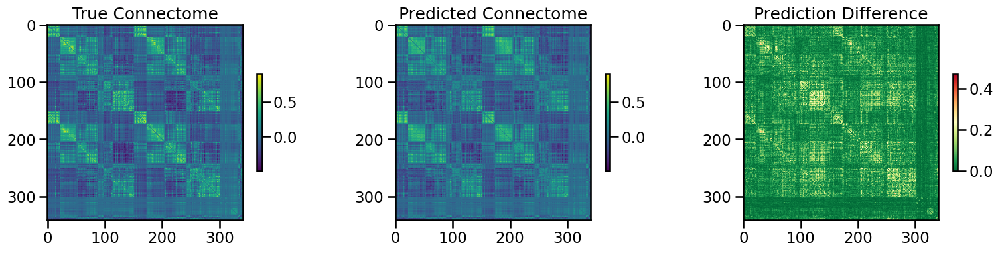

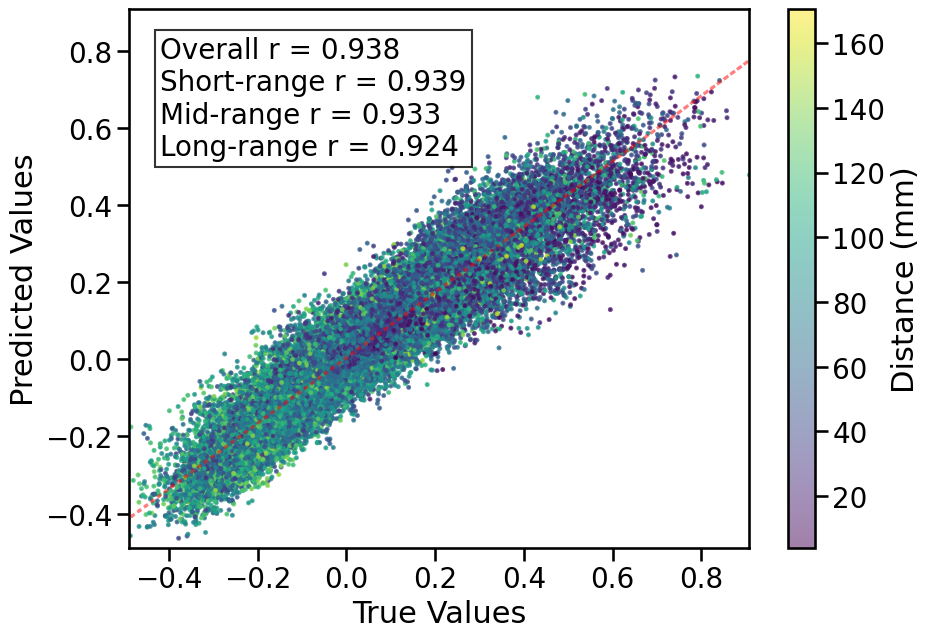

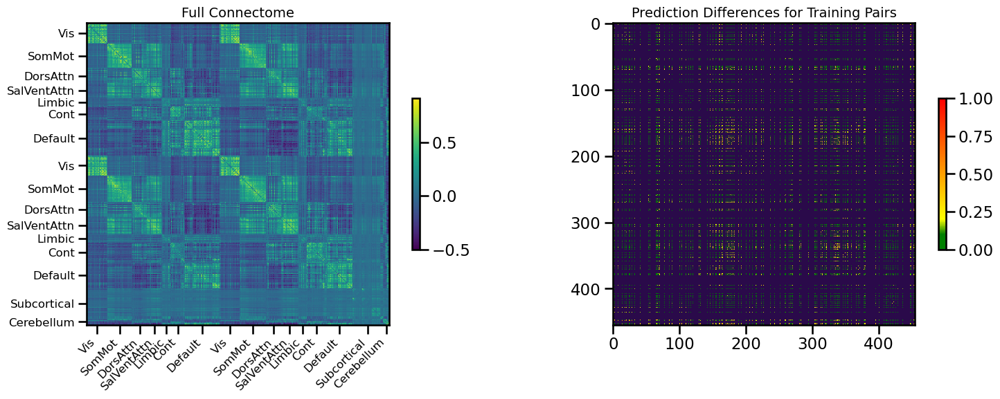

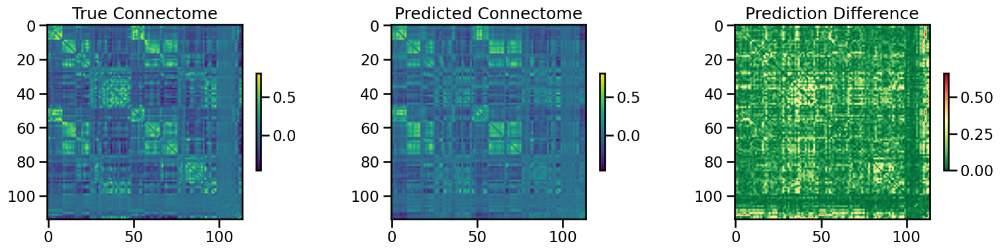

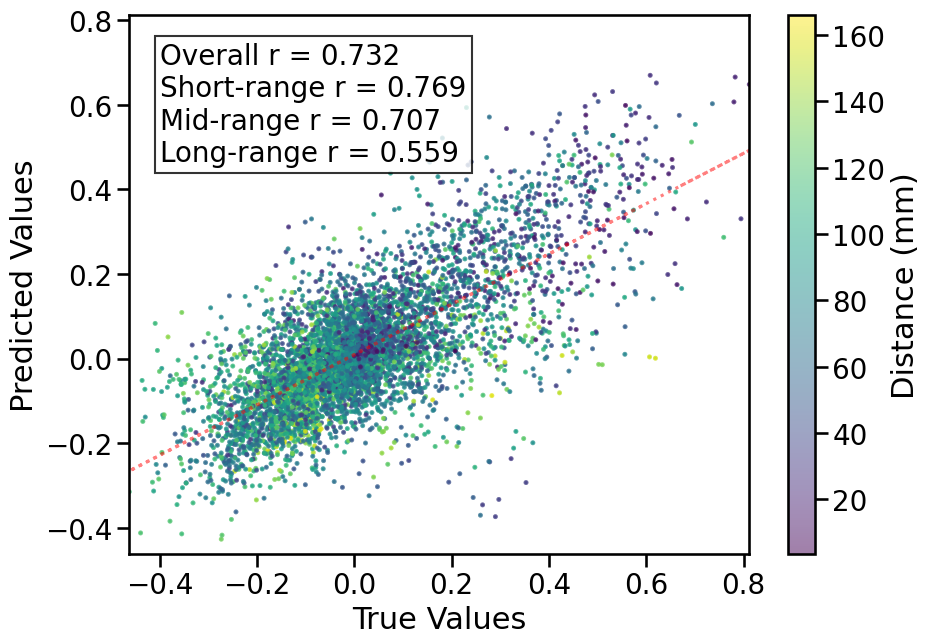


TRAIN METRICS: {'mse': 0.0041469517, 'mae': 0.04537188, 'r2': 0.8784466832027069, 'pearson_r': 0.9378328698464512, 'short_r': 0.9389293273241243, 'mid_r': 0.9331409530967493, 'long_r': 0.9240676967472623, 'geodesic_distance': 15.50520833305544}
TEST METRICS: {'mse': 0.014660512, 'mae': 0.08609255, 'r2': 0.5280182535957447, 'pearson_r': 0.7316531087770076, 'short_r': 0.7689656137196363, 'mid_r': 0.7069333865718217, 'long_r': 0.5592897411789558, 'geodesic_distance': 11.077310007888261}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'activation': Identity(), 'learning_rate': 0.0001, 'epochs': 125, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True}


  warnings.warn(



1
3
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 125}
Number of learnable parameters in bilinear low rank model: 73800
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0365
Best val loss so far at epoch 2: 0.0327
Best val loss so far at epoch 3: 0.0295
Best val loss so far at epoch 4: 0.0283
Best val loss so far at epoch 5: 0.0281
Epoch 5/125, Train Loss: 0.0230, Val Loss: 0.0281, Time: 3.70s
Best val loss so far at epoch 6: 0.0273
Best val loss so far at epoch 7: 0.0244
Best val loss so far at epoch 9: 0.0233
Epoch 10/125, Train Loss: 0.0183, Val Loss: 0.0243, Time: 4.12s
Best val loss so far at epoch 11: 0.0217
Best val loss so far at epoch 12: 0.0215
Best val loss so far at epoch 13: 0.0208
Best val loss so far at epoch 14: 0.0206
Best val loss so far 

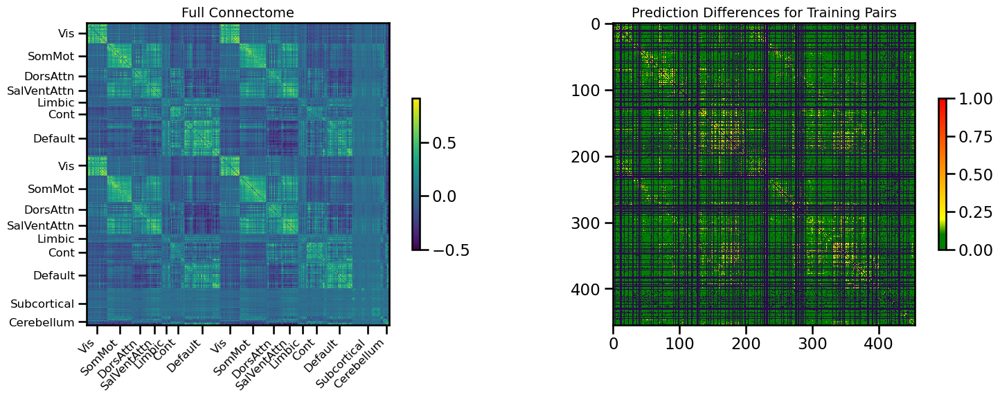

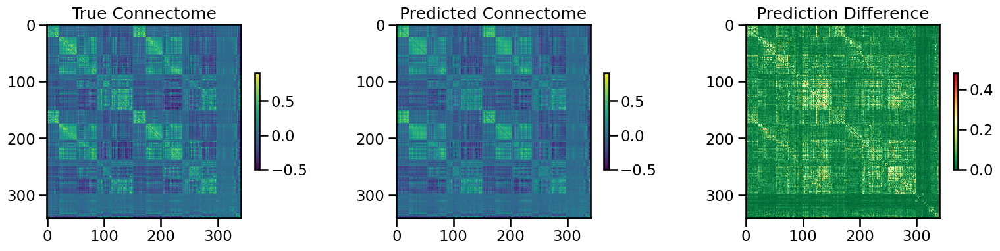

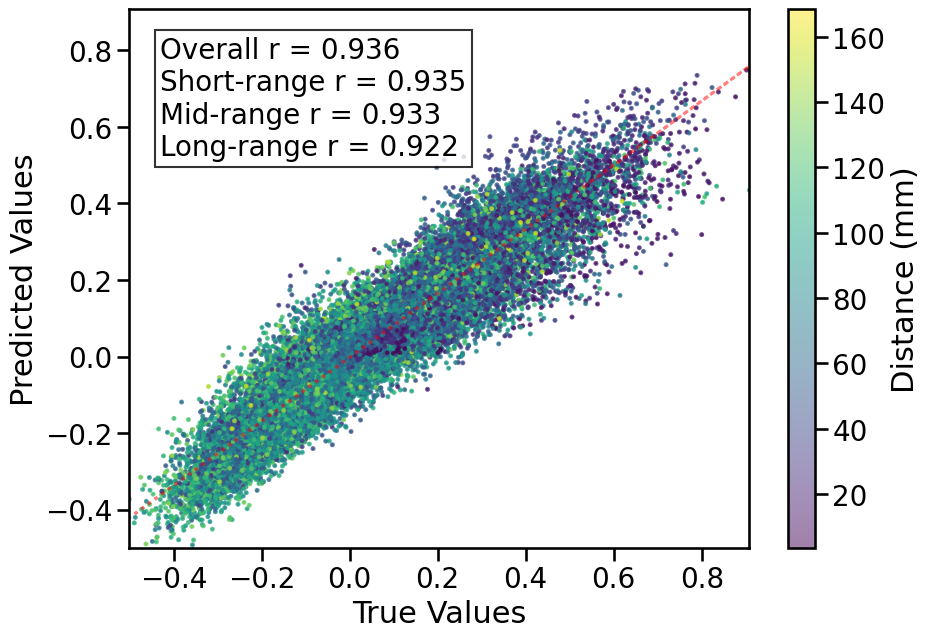

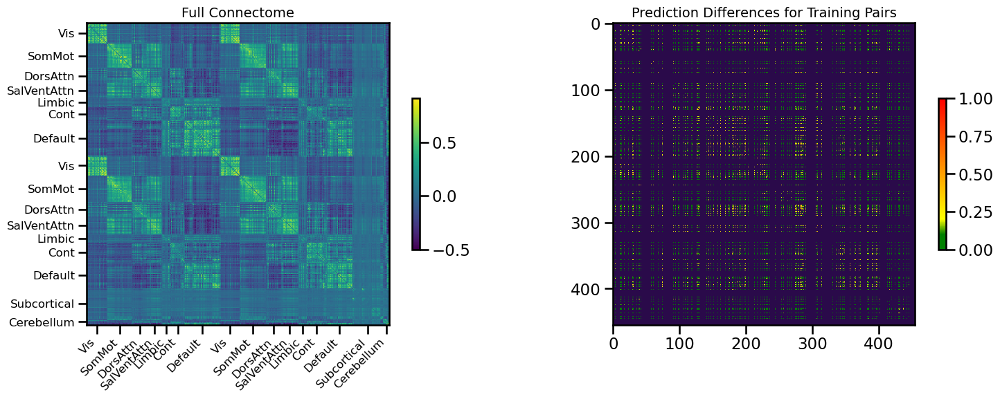

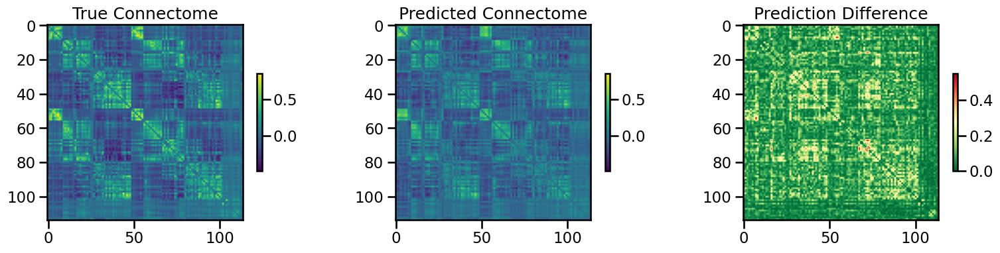

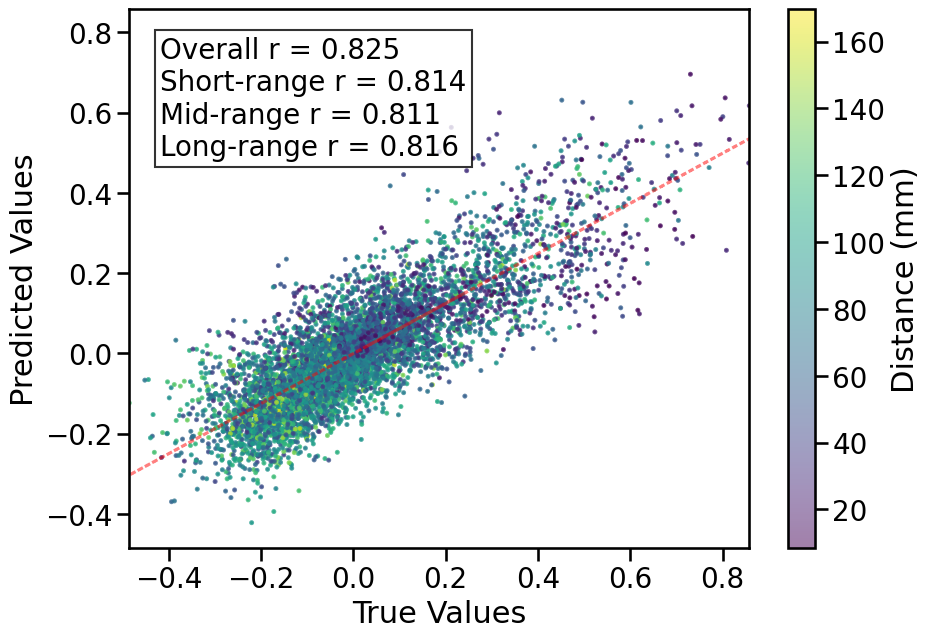


TRAIN METRICS: {'mse': 0.004046477, 'mae': 0.044126477, 'r2': 0.874320330812282, 'pearson_r': 0.9364482597766166, 'short_r': 0.9352417694905851, 'mid_r': 0.9333697615722447, 'long_r': 0.9217571104645262, 'geodesic_distance': 17.16929718869666}
TEST METRICS: {'mse': 0.012089328, 'mae': 0.08123085, 'r2': 0.67546706850603, 'pearson_r': 0.8251249059115395, 'short_r': 0.8136206657301022, 'mid_r': 0.8113290119527987, 'long_r': 0.8162430582563437, 'geodesic_distance': 9.709570541733319}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'activation': Identity(), 'learning_rate': 0.0001, 'epochs': 125, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True}


  warnings.warn(



1
2
4
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 8, 'epochs': 125}
Number of learnable parameters in bilinear low rank model: 59040
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0285
Best val loss so far at epoch 2: 0.0266
Best val loss so far at epoch 3: 0.0241
Best val loss so far at epoch 4: 0.0239
Best val loss so far at epoch 5: 0.0216
Epoch 5/125, Train Loss: 0.0242, Val Loss: 0.0216, Time: 3.93s
Best val loss so far at epoch 7: 0.0215
Best val loss so far at epoch 8: 0.0203
Best val loss so far at epoch 9: 0.0200
Epoch 10/125, Train Loss: 0.0192, Val Loss: 0.0201, Time: 3.87s
Best val loss so far at epoch 11: 0.0198
Best val loss so far at epoch 13: 0.0190
Epoch 15/125, Train Loss: 0.0153, Val Loss: 0.0195, Time: 4.02s
Best val loss so far at epoch 16: 0.0187

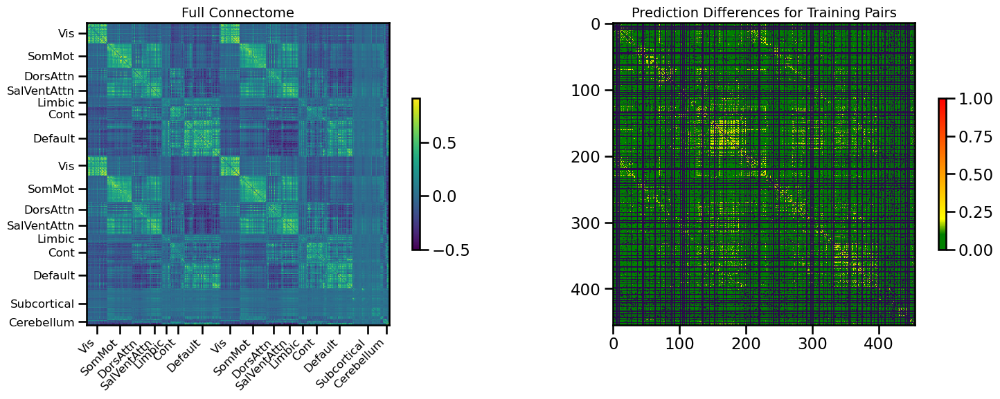

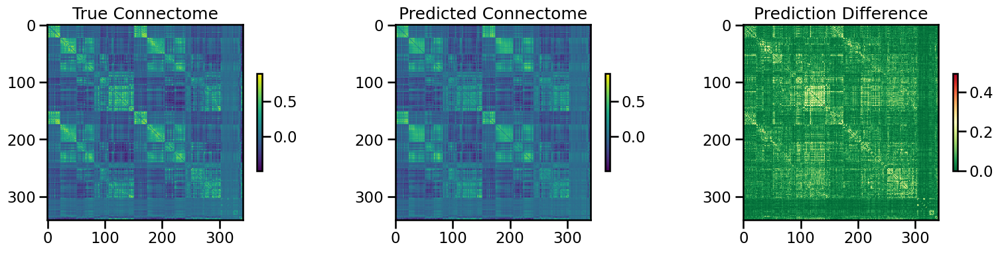

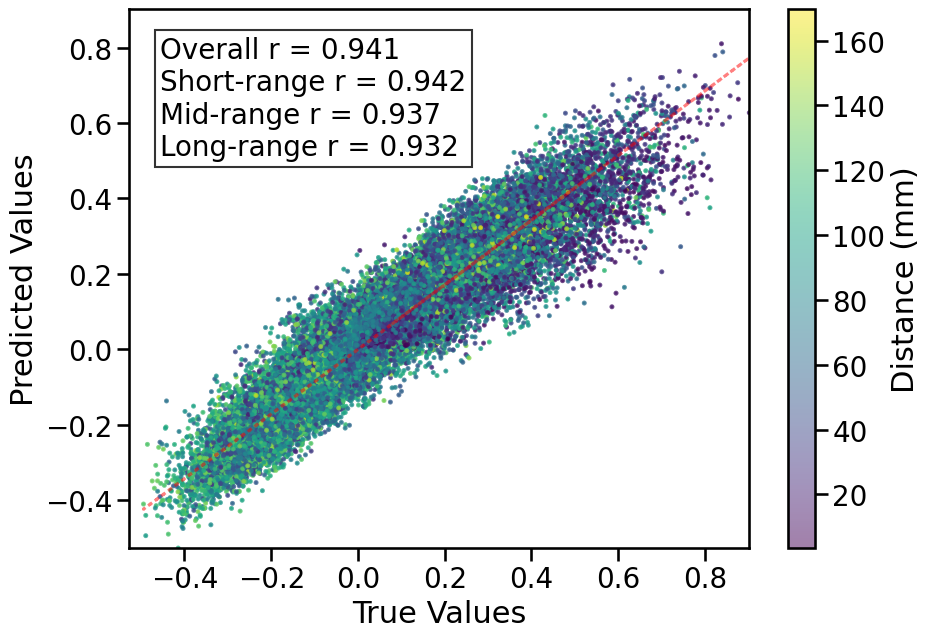

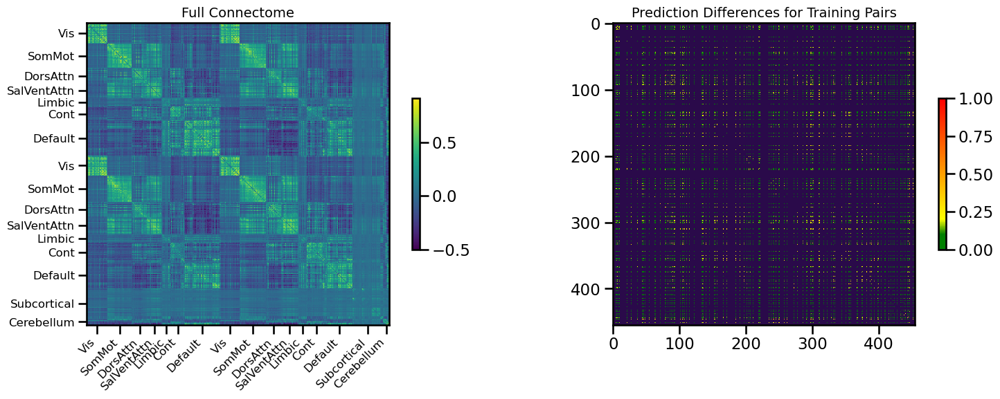

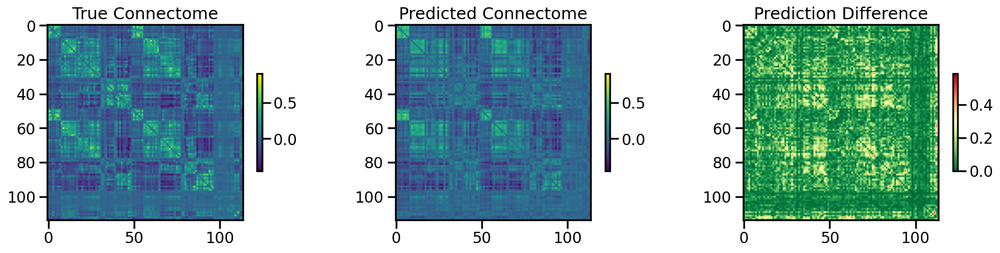

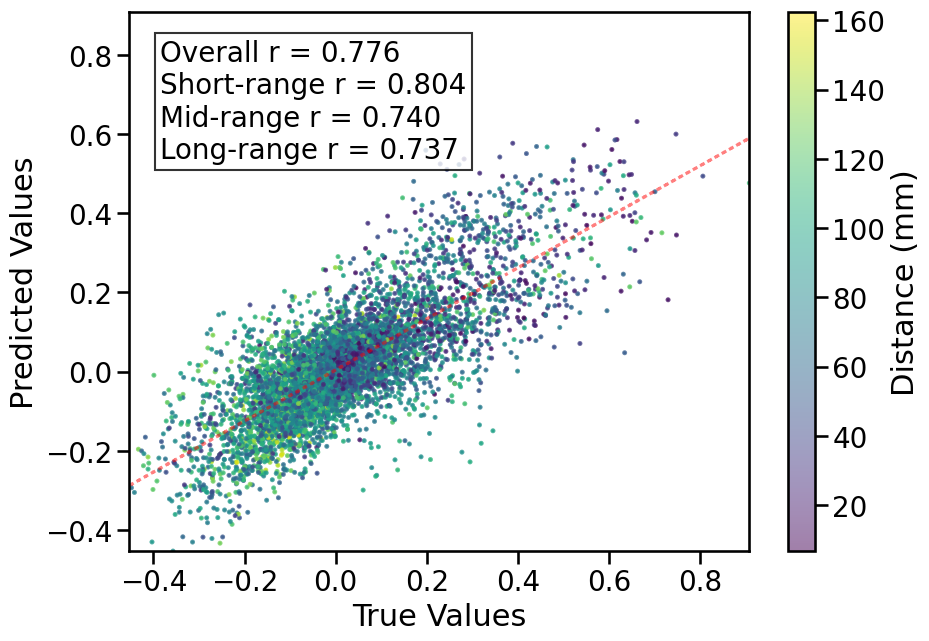


TRAIN METRICS: {'mse': 0.00405727, 'mae': 0.044971026, 'r2': 0.8843053948151622, 'pearson_r': 0.9409505285270943, 'short_r': 0.9415112116796613, 'mid_r': 0.9372416049830115, 'long_r': 0.9316847234289201, 'geodesic_distance': 16.96758298174785}
TEST METRICS: {'mse': 0.011473821, 'mae': 0.07800795, 'r2': 0.5985054579040427, 'pearson_r': 0.7758406308083202, 'short_r': 0.8042032156925083, 'mid_r': 0.7396804522462065, 'long_r': 0.7365679019755185, 'geodesic_distance': 11.800809620477528}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'activation': Identity(), 'learning_rate': 0.0001, 'epochs': 125, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True}


  warnings.warn(



1
2
3
BEST CONFIG {'input_dim': 14760, 'binarize': False, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 8, 'epochs': 125}
Number of learnable parameters in bilinear low rank model: 59040
Using device: cuda
GPU 0: NVIDIA A100-SXM4-80GB - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0361
Best val loss so far at epoch 2: 0.0335
Best val loss so far at epoch 3: 0.0303
Best val loss so far at epoch 4: 0.0273
Best val loss so far at epoch 5: 0.0261
Epoch 5/125, Train Loss: 0.0251, Val Loss: 0.0261, Time: 3.97s
Best val loss so far at epoch 8: 0.0246
Best val loss so far at epoch 9: 0.0234
Epoch 10/125, Train Loss: 0.0191, Val Loss: 0.0254, Time: 3.88s
Best val loss so far at epoch 11: 0.0227
Best val loss so far at epoch 12: 0.0226
Best val loss so far at epoch 13: 0.0220
Best val loss so far at epoch 14: 0.0218
Epoch 15/125, Train Loss: 0.0153, Val Loss: 0.0233, Time: 3.94

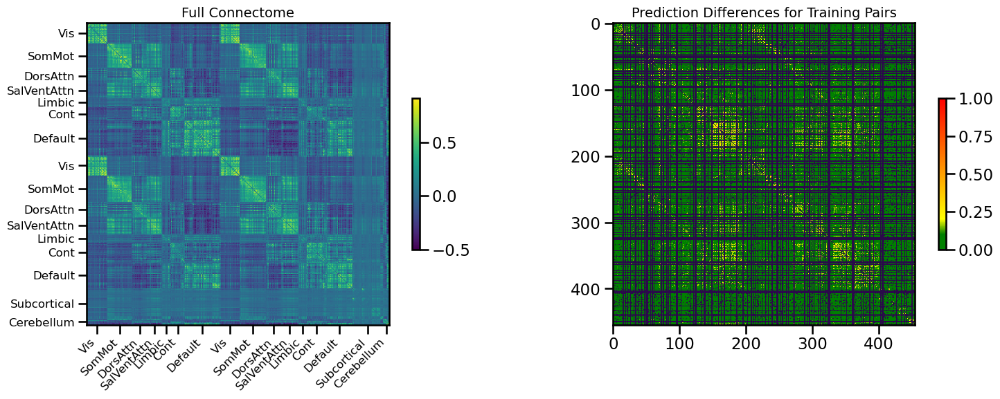

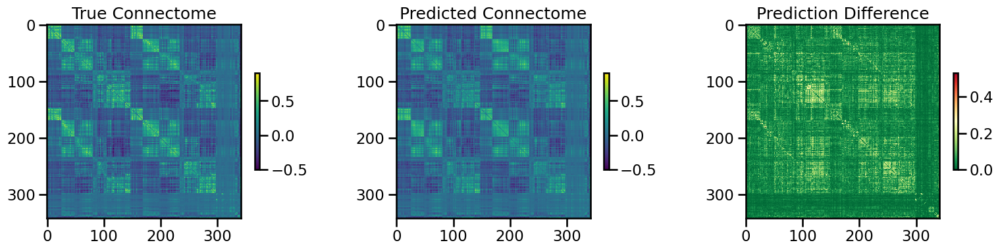

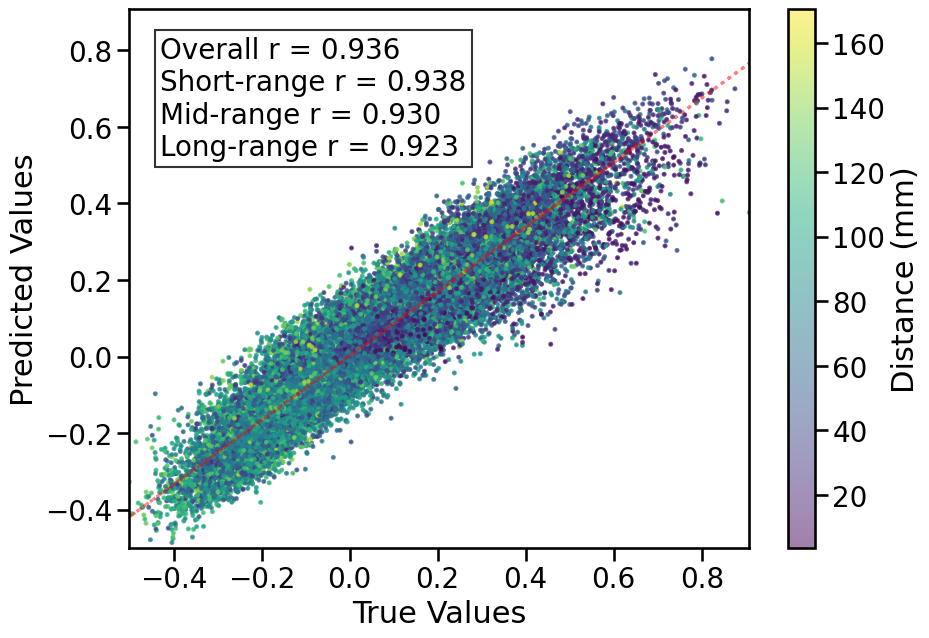

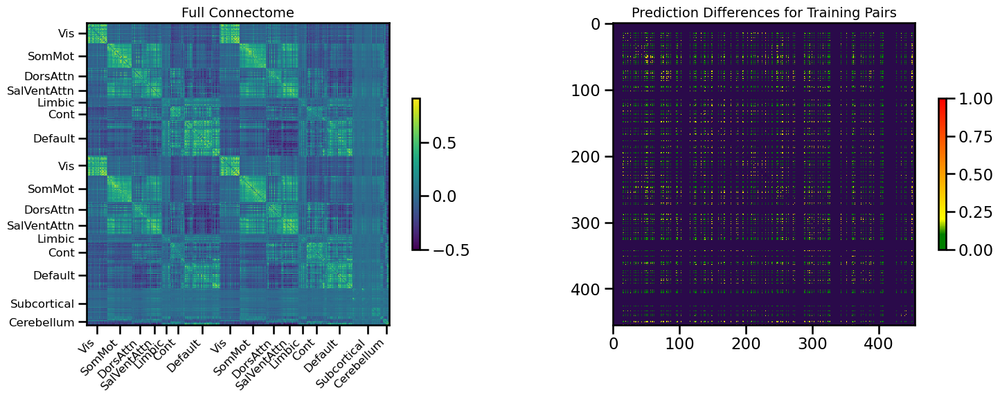

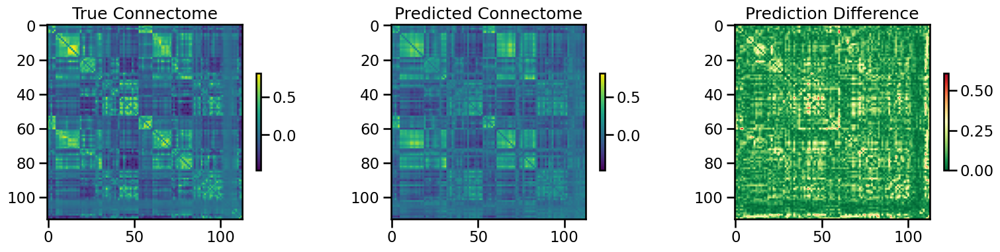

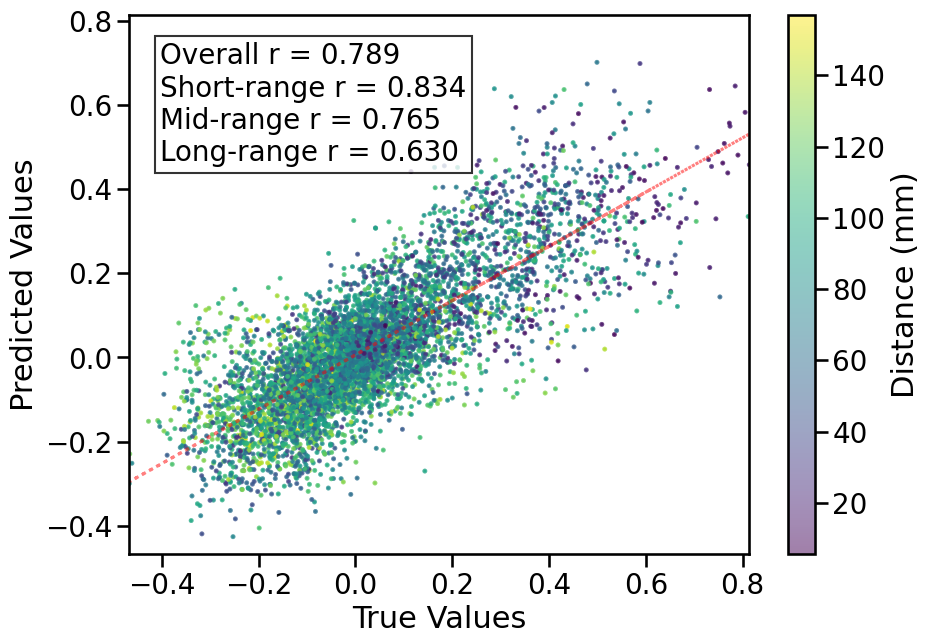


TRAIN METRICS: {'mse': 0.004115823, 'mae': 0.044721667, 'r2': 0.8742282010356025, 'pearson_r': 0.9356982572487043, 'short_r': 0.9375038875851054, 'mid_r': 0.9298446777572603, 'long_r': 0.9229179368642657, 'geodesic_distance': 16.822393859406784}
TEST METRICS: {'mse': 0.013983597, 'mae': 0.087509744, 'r2': 0.6207657862733513, 'pearson_r': 0.7885366184578675, 'short_r': 0.8337424698008694, 'mid_r': 0.7650105321444651, 'long_r': 0.6299515729412939, 'geodesic_distance': 10.873402510134083}
BEST VAL SCORE 0.0
BEST MODEL HYPERPARAMS {'activation': Identity(), 'learning_rate': 0.0001, 'epochs': 125, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True}
CPU Usage: 3.8%
RAM Usage: 29.4%
Available RAM: 710.8G
Total RAM: 1007.0G
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 2077.99 seconds (34.63 minutes)


5818

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}, {'euclidean': None}],
              use_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              parcellation='S400',
              hemisphere='both',
              connectome_target='FC',
              binarize=False,
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='random',
              random_seed=2,
              search_method=('wandb', 'mse', 5),
              track_wandb=False,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True, 
              null_model='none'
              )

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()
# Clear CPU memory
gc.collect()